# Taller 1

## Objetivo:
Evaluar las capacidades del estudiante para realizar análisis de datos utilizando técnicas
estadísticas y de visualización que permitan entender un conjunto de datos, descubrir
insights y plantear hipótesis de negocio.


## Descripción
Para este taller se utilizará una base de datos de Spotify en donde se encuentran las
canciones más escuchadas incluyendo características tanto intrínsecas como extrínsecas
de cada canción. A continuación, se relaciona el diccionario de datos:

| Field            | Description                                                           |
|------------------|-----------------------------------------------------------------------|
| artist           | Song`s artist                                                         |
| song             | Name of the Track                                                     |
| duration_ms      | Duration of the track in milliseconds                                 |
| explicit         | Explicit content                                                      |
| year             | Release Year of the track                                             |
| popularity       | The higher the value the more popular the song is                     |
| danceability     | A value of 0.0 is least danceable and 1.0 is most danceable           |
| energy           | Represents a perceptual measure of intensity and activity             |
| key              | The key the track is in                                               |
| loudness         | The overall loudness of a track in decibels (dB)                      |
| mode             | The modality (major or minor) of a track                              |
| speechiness      | Speechiness detects the presence of spoken words in a track           |
| acousticness     | A confidence measure from 0.0 to 1.0 of whether the track is acoustic |
| instrumentalness | Predicts whether a track contains no vocals                           |
| liveness         | Detects the presence of an audience in the recording                  |
| valence          | A measure from 0.0 to 1.0 describing the musical positiveness         |
| tempo            | The overall estimated tempo of a track in beats per minute (BPM)      |
| genre            | Genre of the track                                                    |

## Actividades
Responda cada una de las siguientes preguntas de negocio utilizando las técnicas y
herramientas vistas en clase. En la medida de lo posible, responda cada pregunta
aplicando una técnica estadística acompañada de una visualización.


## Punto 1 (5 pts)
Describa el conjunto de datos, tipos de variables y destaque cualquier problema de calidad
de datos y procesos de limpieza que deba implementar.




*   Inicializacion del ambiente de trabajo:



In [1]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip (22.0 MB)


In [2]:
#Manejo de datos
import pandas as pd
import numpy as np

#Visualización de datos
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

#Analisis profundo de datos
import sklearn
from pandas_profiling import ProfileReport
from sklearn.preprocessing import MultiLabelBinarizer

vamos a realizar la exploración de datos. Así que, leeremos los datos.

El archivo no era legible originalmente por problemas de comillas mal colocadas, por lo que se abrio en excel, se elimino 1 fila mal formateada, y se volvio a guardar, ya que excel arregla este tipo de problemas en CSV automaticamente.

In [3]:
url = 'https://raw.githubusercontent.com/a-garcia13/CD_Taller1/main/Data_Taller_1.csv'

data = pd.read_csv(url, sep=";")
data #Veremos el dataset, para ver si leyó correctamente

,artist,song,duration_ms,explicit,year,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,genre
0,Britney Spears,Oops!...I Did It Again,211160.0,False,2000,77.0,0.751,0.834,1,-5.444,0,0.0437,0.3000,0.000018,0.3550,0.894,95.053,pop
1,blink-182,All The Small Things,167066.0,False,1999,79.0,0.434,0.897,0,-4.918,1,0.0488,0.0103,0.000000,0.6120,0.684,148.726,"rock, pop"
2,Faith Hill,Breathe,250546.0,False,1999,66.0,0.529,0.496,7,-9.007,1,0.0290,0.1730,0.000000,0.2510,0.278,136.859,"pop, country"
3,Bon Jovi,It's My Life,224493.0,False,2000,78.0,0.551,0.913,0,-4.063,0,0.0466,0.0263,0.000013,0.3470,0.544,119.992,"rock, metal"
4,*NSYNC,Bye Bye Bye,200560.0,False,2000,NaN,0.614,0.928,8,-4.806,0,0.0516,0.0408,0.001040,0.0845,0.879,172.656,pop
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1993,Jonas Brothers,Sucker,181026.0,False,2019,79.0,0.842,0.734,1,-5.065,0,0.0588,0.0427,0.000000,0.1060,0.952,137.958,pop
1994,Taylor Swift,Cruel Summer,178426.0,False,2019,78.0,0.552,0.702,9,-5.707,1,0.1570,0.1170,0.000021,0.1050,0.564,169.994,pop
1995,Blanco Brown,The Git Up,200593.0,False,2019,69.0,0.847,0.678,9,-8.635,1,0.1090,0.0669,0.000000,0.2740,0.811,NaN,"hip hop, country"
1996,Sam Smith,Dancing With A Stranger (with Normani),171029.0,False,2019,75.0,0.741,0.520,8,-7.513,1,0.0656,0.4500,0.000002,0.2220,0.347,102.998,pop


Ahora procederemos con el primer perfilamiento de los datos para buscar cualquier tipo de problema:

In [4]:
ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Se encontraron la siguiente lista de problemas:

*   Dataset has 59 (2.9%) duplicate rows
*   Missing cells:	35
*   Existe alta correlacion entre varias variables
*   Varias variables tienen alta cardinalidad

De estos, solo solucionaremos los primeros tres problemas, ya que los otros solo serian significativos a la hora de implementar un modelo de regresion/clasificacion.



Eliminar duplicados:

In [5]:
data.shape

(1998, 18)

In [6]:
data = data.drop_duplicates()
data.shape

(1939, 18)

Eliminar filas con valores vacios:

In [7]:
data = data.dropna()
data.shape

(1920, 18)

Volveremos a correr el perfilador para observar los cambios

In [8]:
ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Descripcion de los datos:
| Field            | Description                                                           | Tipo    | Variable          | Rango              | Hallazgos                                    |
|------------------|-----------------------------------------------------------------------|---------|-------------------|--------------------|----------------------------------------------|
| artist           | Song`s artist                                                         | String  | Categorica        | 827 categorias     | Alta cardinalidad                            |
| song             | Name of the Track                                                     | String  | Categorica        | 1859 categorias    | Alta cardinalidad, Uniformemente distribuido |
| duration_ms      | Duration of the track in milliseconds                                 | Integer | Numeros Positivos | 113000-484146      | Alta cardinalidad, Uniformemente distribuido |
| explicit         | Explicit content                                                      | Boolean | Categorica        | Verdadero-Falso    | Alta correlacion                             |
| year             | Release Year of the track                                             | Integer | Numeros Positivos | 1998-2020          | Alta correlacion                             |
| popularity       | The higher the value the more popular the song is                     | Float   | Numeros Positivos | 0-89               | Alta correlacion, Sesgada                    |
| danceability     | A value of 0.0 is least danceable and 1.0 is most danceable           | Float   | Numeros Positivos | 0.129-0.975        |                                              |
| energy           | Represents a perceptual measure of intensity and activity             | Float   | Numeros Positivos | 0.0549-0.999       | Alta Correlacion                             |
| key              | The key the track is in                                               | Integer | Numeros Positivos | 0-11               |                                              |
| loudness         | The overall loudness of a track in decibels (dB)                      | Float   | Numeros negativos | (-20.514)-(-0.276) | Alta Correlacion                             |
| mode             | The modality (major or minor) of a track                              | Integer | Categorica        | 0 y 1              |                                              |
| speechiness      | Speechiness detects the presence of spoken words in a track           | Float   | Numeros Positivos | 0.0232-0.576       | Alta Correlacion                             |
| acousticness     | A confidence measure from 0.0 to 1.0 of whether the track is acoustic | Float   | Numeros Positivos | 1.92x10e-5-0.976   | Alta Correlacion                             |
| instrumentalness | Predicts whether a track contains no vocals                           | Float   | Numeros Positivos | 0-0.985            | Alta Correlacion                             |
| liveness         | Detects the presence of an audience in the recording                  | Float   | Numeros Positivos | 0.0234-0.853       |                                              |
| valence          | A measure from 0.0 to 1.0 describing the musical positiveness         | Float   | Numeros Positivos | 0.0381-0.973       |                                              |
| tempo            | The overall estimated tempo of a track in beats per minute (BPM)      | Float   | Numeros Positivos | 60.019-210.851     |                                              |
| genre            | Genre of the track                                                    | String  | Categorica        | 58 categorias      | Alta cardinalidad, Alta correlacion          |

##Punto 2
¿Cuál es el top 10 de artistas más activos de los últimos 10 años?


Para responder esta pregunta vamos a considerar los artistas mas activos como los artistas que mas canciones tienen en el dataset entre el 2011-2020

Primero filtramos las canciones del 2011 en adelante

In [9]:
data_2 = data[data['year'] > 2010] 
data_2.shape

(879, 18)

Despues, agrupamos por artista

In [10]:
data_2 = data_2.groupby(['artist']).size().reset_index(name='count')
data_2 = data_2.sort_values('count', ascending=False)
data_2

,artist,count
113,Drake,19
67,Calvin Harris,17
101,David Guetta,13
27,Ariana Grande,13
381,Taylor Swift,12
...,...,...
78,Chase & Status,1
250,MEDUZA,1
251,MGMT,1
252,MK,1


Y los siguientes son los artistas mas activos:

In [11]:
data_2.head(10)

,artist,count
113,Drake,19
67,Calvin Harris,17
101,David Guetta,13
27,Ariana Grande,13
381,Taylor Swift,12
197,Katy Perry,11
85,Chris Brown,10
33,Avicii,10
267,Maroon 5,9
119,Ed Sheeran,9


## Punto 3 (10 pts)
¿Cómo se diferencian las canciones de los géneros de Latin y Folk/Acoustic en relación con
su duración? Halle la diferencia del tiempo promedio de ambos géneros

Primero es necesario hacer un hot one encoder en la columna de genero para poder identificar cada genero particular de cada cancion, ya que tienen multiples generos

In [12]:
data_3 = data #Duplicamos el data set, para no dañar el original
data_3['genre'] = data_3['genre'].str.replace(" ","") #quitamos los espacios en blanco para que quede bien
data_3['genre']=data_3['genre'].str.split(',')
label = data_3['genre']
mlb = MultiLabelBinarizer()
one_hot = pd.DataFrame(data=mlb.fit_transform(label),columns=mlb.classes_)
one_hot.head()

,Dance/Electronic,Folk/Acoustic,R&B,World/Traditional,blues,classical,country,easylistening,hiphop,jazz,latin,metal,pop,rock,set()
0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0
2,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0
3,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0
4,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0


In [13]:
mlb.classes_

array(['Dance/Electronic', 'Folk/Acoustic', 'R&B', 'World/Traditional',
       'blues', 'classical', 'country', 'easylistening', 'hiphop', 'jazz',
       'latin', 'metal', 'pop', 'rock', 'set()'], dtype=object)

In [14]:
data_3.reset_index(drop=True, inplace=True)
one_hot.reset_index(drop=True, inplace=True)
data_3 = pd.concat([data_3, one_hot], axis=1)
data_3.head()

,artist,song,duration_ms,explicit,year,popularity,danceability,energy,key,loudness,...,classical,country,easylistening,hiphop,jazz,latin,metal,pop,rock,set()
0,Britney Spears,Oops!...I Did It Again,211160.0,False,2000,77.0,0.751,0.834,1,-5.444,...,0,0,0,0,0,0,0,1,0,0
1,blink-182,All The Small Things,167066.0,False,1999,79.0,0.434,0.897,0,-4.918,...,0,0,0,0,0,0,0,1,1,0
2,Faith Hill,Breathe,250546.0,False,1999,66.0,0.529,0.496,7,-9.007,...,0,1,0,0,0,0,0,1,0,0
3,Bon Jovi,It's My Life,224493.0,False,2000,78.0,0.551,0.913,0,-4.063,...,0,0,0,0,0,0,1,0,1,0
4,Sisqo,Thong Song,253733.0,True,1999,69.0,0.706,0.888,2,-6.959,...,0,0,0,1,0,0,0,1,0,0


vamos a crear 2 datasets, el primero va a ser todas las canciones que contengan Latin en el genero, y el segundo todas las canciones que contengan Folk/Acoustic en el genero

In [15]:
data_3_latin = data_3[data_3['latin'] == 1] 
data_3_latin

,artist,song,duration_ms,explicit,year,popularity,danceability,energy,key,loudness,...,classical,country,easylistening,hiphop,jazz,latin,metal,pop,rock,set()
39,Enrique Iglesias,Be With You,219360.0,False,1999,54.0,0.683,0.866,1,-5.436,...,0,0,0,0,0,1,0,1,0,0
50,Ricky Martin,She Bangs - English Version,280626.0,False,2000,60.0,0.630,0.950,1,-4.012,...,0,0,0,0,0,1,0,1,0,0
68,Santana,Maria Maria (feat. The Product G&B),261973.0,False,1999,66.0,0.777,0.601,2,-5.931,...,0,0,0,0,0,1,0,0,1,0
86,Marc Anthony,You Sang To Me,347106.0,False,1999,56.0,0.578,0.894,10,-5.420,...,0,0,0,0,0,1,0,1,0,0
103,Nelly Furtado,I'm Like A Bird,243160.0,False,2000,1.0,0.622,0.608,10,-5.085,...,0,0,0,1,0,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1883,Bad Bunny,Callaita,250533.0,True,2019,81.0,0.610,0.624,2,-4.773,...,0,0,0,0,0,1,0,0,0,0
1885,Pedro Capó,Calma - Remix,238200.0,False,2018,74.0,0.826,0.773,11,-4.218,...,0,0,0,0,0,1,0,1,0,0
1887,Lunay,Soltera - Remix,266086.0,False,2019,70.0,0.795,0.783,5,-4.271,...,0,0,0,0,0,1,0,1,0,0
1902,Anuel AA,Secreto,258800.0,False,2019,75.0,0.807,0.803,11,-4.156,...,0,0,0,0,0,1,0,0,0,0


In [16]:
data_3_folk = data_3[data_3['Folk/Acoustic'] == 1] 
data_3_folk

,artist,song,duration_ms,explicit,year,popularity,danceability,energy,key,loudness,...,classical,country,easylistening,hiphop,jazz,latin,metal,pop,rock,set()
20,Tom Jones,Sexbomb,211893.0,False,1999,65.0,0.801,0.876,8,-3.940,...,0,0,1,0,0,0,0,0,1,0
58,Oasis,Go Let It Out,278666.0,False,2000,0.0,0.408,0.849,2,-5.631,...,0,0,0,0,0,0,0,0,1,0
91,The Corrs,Breathless,207506.0,False,2000,68.0,0.607,0.820,11,-7.754,...,0,0,0,0,0,0,0,1,0,0
163,Enya,Only Time,218546.0,False,2000,69.0,0.418,0.249,3,-13.744,...,0,0,0,0,0,0,0,0,0,0
196,Vanessa Carlton,A Thousand Miles,237493.0,False,2002,75.0,0.560,0.825,11,-3.862,...,0,0,0,0,0,0,0,1,0,0
275,Alanis Morissette,Hands Clean,269400.0,False,2002,57.0,0.513,0.820,7,-5.428,...,0,0,0,0,0,0,0,1,0,0
283,Michelle Branch,All You Wanted,217680.0,False,2001,60.0,0.499,0.720,8,-9.101,...,0,0,0,0,0,0,0,1,0,0
328,Simply Red,Sunrise,199040.0,False,2008,58.0,0.791,0.733,5,-5.123,...,0,0,0,0,0,0,0,1,1,0
523,Rob Thomas,Lonely No More,226640.0,False,2005,56.0,0.551,0.896,9,-3.152,...,0,0,0,0,0,0,0,1,0,0
535,Natalie Imbruglia,Shiver,222653.0,False,2005,52.0,0.489,0.798,1,-4.490,...,0,0,0,0,0,0,0,1,0,0


ahora sacamos el promedio de ambos sets

In [17]:
mean_folk = data_3_folk["duration_ms"].mean()
mean_folk

220183.65

In [18]:
mean_latin = data_3_latin["duration_ms"].mean()
mean_latin

226583.70491803277

y la diferencia es:

In [19]:
diferencia = abs(mean_latin-mean_folk)
diferencia

6400.05491803278

Por lo que sabemos que en promedio, las canciones de genero latin duran mas que las de folk

## Punto 4 (15 pts)
Halle el top 5 de los géneros del 2019 según la cantidad de canciones. ¿Cómo ha variado la
cantidad de canciones del Top de géneros en los años 2000, 2005, 2010, 2015, 2019?

Para este punto, podemos aprovechar el dataset del punto anterior que ya tiene los generos como un hot one encoder. vamos a encontrar el top 5 de todos los años descritos en el punto anterir

In [20]:
data_4 = data_3
data_4 = data_4.groupby(['year'], as_index=False).agg('sum')
years = [2000,2005,2010,2015,2019]
data_4 = data_4[data_4['year'].isin(years)]
data_4 = data_4[np.append(['year'],mlb.classes_)]
data_4

,year,Dance/Electronic,Folk/Acoustic,R&B,World/Traditional,blues,classical,country,easylistening,hiphop,jazz,latin,metal,pop,rock,set()
2,2000,4,3,24,1,0,0,0,0,19,0,2,7,53,12,0
7,2005,5,4,30,2,0,0,3,1,50,1,3,5,78,18,1
12,2010,28,0,22,1,0,0,3,1,52,0,2,0,94,6,0
17,2015,26,0,19,0,0,1,0,0,29,0,0,2,80,13,0
21,2019,20,0,9,0,0,0,0,0,35,0,8,2,62,2,1


Luego encontramos los generos mas populares

In [21]:
max = data_4.drop(['year','set()'], axis=1)
max = max.sum(axis=0).sort_values(ascending=False)
top_genres = max.head(5)
top_genres

pop                 367
hiphop              185
R&B                 104
Dance/Electronic     83
rock                 51
dtype: int64

Ahora graficamos:

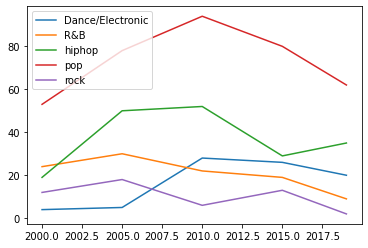

<Figure size 1440x1440 with 0 Axes>

In [22]:
x = data_4['year']
lines = data_4.drop(['year','set()'], axis=1)
for (columnName, columnData) in lines.iteritems():
  if columnName in top_genres.index:
    plt.plot(x,columnData.values, label = columnName)
plt.legend()
plt.figure(figsize=(20,20)) 
plt.show()

# Punto 5 (15 pts)
¿Cómo ha sido la progresión de nuevos artistas? Asuma que un artista nuevo es aquel del
cual no se tiene registros pasados y solo es nuevo durante el primer año de aparición.


In [23]:
data_5 = data
data_5 = data_5.groupby(['artist'], as_index=False).agg('min')
data_5

,artist,song,duration_ms,explicit,year,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,genre
0,*NSYNC,Girlfriend,191040.0,False,2000,45.0,0.644,0.403,0,-8.564,0,0.0614,0.04590,0.000000,0.0283,0.500,93.967,[pop]
1,112,It's Over Now,193093.0,False,2001,57.0,0.660,0.520,1,-6.255,0,0.0409,0.00277,0.000000,0.0532,0.233,97.988,"[hiphop, pop, R&B]"
2,2 Chainz,It's A Vibe,210200.0,False,2013,69.0,0.563,0.502,1,-7.380,0,0.1480,0.03120,0.000000,0.0524,0.525,73.003,"[hiphop, pop]"
3,21 Savage,Bank Account,220306.0,True,2017,74.0,0.837,0.347,1,-8.227,0,0.0860,0.01500,0.000007,0.0871,0.274,75.016,[hiphop]
4,2Pac,Ghetto Gospel,238053.0,True,2001,57.0,0.757,0.614,5,-6.665,0,0.0467,0.02670,0.000000,0.0788,0.375,80.569,[hiphop]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
822,girl in red,we fell in love in october,184153.0,False,2018,82.0,0.566,0.366,7,-12.808,1,0.0280,0.11300,0.181000,0.1550,0.237,129.959,"[pop, rock, Dance/Electronic]"
823,iann dior,emotions,131213.0,False,2019,69.0,0.630,0.630,9,-6.211,1,0.0287,0.01310,0.000000,0.0717,0.163,80.512,"[hiphop, pop]"
824,iio,Rapture (feat.Nadia Ali),253586.0,False,2006,54.0,0.661,0.855,8,-8.403,1,0.0377,0.07220,0.018500,0.1990,0.601,123.943,[Dance/Electronic]
825,t.A.T.u.,All The Things She Said,214440.0,True,2020,39.0,0.527,0.834,5,-5.767,0,0.0474,0.04110,0.005990,0.1050,0.381,179.920,[pop]


In [24]:
x = range(data_5['year'].min(), data_5['year'].max()+1)
progresion = {}
for n in x:
  tmp_df = data_5[data_5['year'] == n]
  progresion[n] = tmp_df['artist'].to_numpy()
progresion

{1998: array(['Missy Elliott'], dtype=object),
 1999: array(['Anastacia', 'Backstreet Boys', 'Britney Spears',
        'Christina Aguilera', 'Crazy Town', 'Creed', 'Céline Dion', 'DMX',
        "Destiny's Child", 'Dido', 'Donell Jones', 'Dr. Dre', 'Eiffel 65',
        'Enrique Iglesias', 'Faith Hill', "Gigi D'Agostino", 'JAY-Z',
        'Madison Avenue', 'Marc Anthony', 'Mariah Carey', 'Melanie C',
        'Montell Jordan', 'Red Hot Chili Peppers', 'Santana',
        'Savage Garden', 'Sisqo', 'Sting', 'Tom Jones', 'Wheatus',
        'blink-182'], dtype=object),
 2000: array(['*NSYNC', '3 Doors Down', '3LW', 'Alice Deejay', 'All Saints',
        'Avant', 'Baha Men', "Bomfunk MC's", 'Bon Jovi', 'Bow Wow',
        'Carl Thomas', 'Craig David', 'Da Brat', 'Debelah Morgan',
        'Eminem', 'Enya', 'Erykah Badu', 'Fuel', 'Jagged Edge', 'Joe',
        'Kandi', 'Kylie Minogue', 'Lenny Kravitz', 'Lifehouse',
        'Limp Bizkit', 'Linkin Park', 'Ludacris', 'M.O.P.', 'Madonna',
        'Mary 

## Punto 6 (15 pts)
Grafique la progresión de la popularidad promedio por género y por año. Concluya sobre
la gráfica, ej: ¿existen tendencias?

Utilizaremos la tabla con generos codificados por hor one encoder, ya que la tarea es mas sencilla para crear un data frame por año y luego sacaremos el promedio de popularidad de cada genero en cada año.

In [25]:
data_6 = data_3
data_6

,artist,song,duration_ms,explicit,year,popularity,danceability,energy,key,loudness,...,classical,country,easylistening,hiphop,jazz,latin,metal,pop,rock,set()
0,Britney Spears,Oops!...I Did It Again,211160.0,False,2000,77.0,0.751,0.834,1,-5.444,...,0,0,0,0,0,0,0,1,0,0
1,blink-182,All The Small Things,167066.0,False,1999,79.0,0.434,0.897,0,-4.918,...,0,0,0,0,0,0,0,1,1,0
2,Faith Hill,Breathe,250546.0,False,1999,66.0,0.529,0.496,7,-9.007,...,0,1,0,0,0,0,0,1,0,0
3,Bon Jovi,It's My Life,224493.0,False,2000,78.0,0.551,0.913,0,-4.063,...,0,0,0,0,0,0,1,0,1,0
4,Sisqo,Thong Song,253733.0,True,1999,69.0,0.706,0.888,2,-6.959,...,0,0,0,1,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1915,Post Malone,Goodbyes (Feat. Young Thug),174960.0,True,2019,1.0,0.580,0.653,5,-3.818,...,0,0,0,1,0,0,0,0,0,0
1916,Jonas Brothers,Sucker,181026.0,False,2019,79.0,0.842,0.734,1,-5.065,...,0,0,0,0,0,0,0,1,0,0
1917,Taylor Swift,Cruel Summer,178426.0,False,2019,78.0,0.552,0.702,9,-5.707,...,0,0,0,0,0,0,0,1,0,0
1918,Sam Smith,Dancing With A Stranger (with Normani),171029.0,False,2019,75.0,0.741,0.520,8,-7.513,...,0,0,0,0,0,0,0,1,0,0


In [26]:
x = range(data_6['year'].min(), data_6['year'].max()+1)
años = {}
for n in x: #creamos un df por año y lo guardamos en el diccionario
  tmp_df = data_6[data_6['year'] == n]
  años[n] = tmp_df
años

{1998:            artist      song  duration_ms explicit  year  popularity  \
 43  Missy Elliott  Hot Boyz     215466.0     True  1998        49.0   
 
     danceability  energy  key  loudness  ...  classical  country  \
 43         0.727   0.445    1   -11.241  ...          0        0   
 
     easylistening  hiphop  jazz  latin  metal pop  rock  set()  
 43              0       1     0      0      0   1     0      0  
 
 [1 rows x 33 columns],
 1999:                     artist                                               song  \
 1                blink-182                               All The Small Things   
 2               Faith Hill                                            Breathe   
 4                    Sisqo                                         Thong Song   
 7          Destiny's Child                                        Say My Name   
 10               Eiffel 65   Move Your Body - Gabry Ponte Original Radio Edit   
 12                   Sting                         

In [27]:
# creamos un dataframe vacio, cuyas columnas son todos los generos y una columna para los años, los datos que almacenaremos seran los promedios de popularidad por genero
df_genre_popularity = pd.DataFrame(columns=np.append(['year'],mlb.classes_))
for n in x: #le aplicamos una agrupacion a cada dataset para sacar la popularidad 
  tmp_df = años[n]
  array_year = {'year':n}
  for genre in mlb.classes_:
    tmp_genre = tmp_df[tmp_df[genre]==1]
    popularity = tmp_genre['popularity'].mean()
    if popularity is np.nan:
      array_year[genre] = 0
    else:
      array_year[genre] = popularity
  df_genre_popularity = df_genre_popularity.append(pd.DataFrame(array_year, index=[n]), ignore_index=True)
df_genre_popularity

,year,Dance/Electronic,Folk/Acoustic,R&B,World/Traditional,blues,classical,country,easylistening,hiphop,jazz,latin,metal,pop,rock,set()
0,1998,0,0,49.000000,0,0,0,0,0,49.000000,0,0,0,49.000000,0,0
1,1999,57.0,65.0,65.000000,0,66.0,0,66.0,65.0,69.857143,0,58.666667,68.0,63.321429,69.25,71.0
2,2000,53.0,45.666667,55.208333,69.0,0,0,0,0,59.684211,0,30.5,70.571429,57.943396,59.333333,0
3,2001,56.833333,60.0,58.571429,0,0,0,62.0,0,60.406250,0,64.666667,66.125,58.177778,58.25,0
4,2002,54.666667,66.0,55.433333,0,0,0,0,60.0,59.883721,0,0,71.2,60.521739,69.153846,66.0
5,2003,52.6,0,59.437500,61.0,3.0,0,0,55.0,61.718750,55.0,55.0,71.25,58.356164,57.538462,0
6,2004,56.444444,0,61.566667,60.0,0,0,0,0,61.785714,0,40.5,60.0,56.873016,61.363636,53.5
7,2005,52.0,60.75,53.733333,67.5,0,0,68.333333,60.0,61.860000,60.0,52.666667,69.4,59.923077,65.388889,46.0
8,2006,54.666667,0,62.607143,48.0,0,0,34.5,0,60.111111,0,80.666667,65.0,55.465753,67.857143,17.0
9,2007,52.375,0,61.515152,0,56.5,0,0,0,58.763158,0,51.0,74.8,57.911765,64.789474,57.0


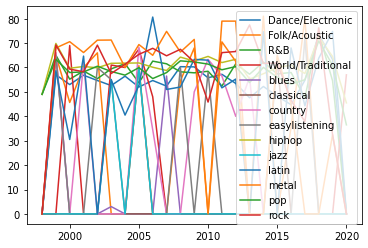

<Figure size 1440x1440 with 0 Axes>

In [28]:
x = df_genre_popularity['year']
lines = df_genre_popularity.drop(['year','set()'], axis=1)
for (columnName, columnData) in lines.iteritems():
  plt.plot(x,columnData.values, label = columnName)
plt.legend()
plt.figure(figsize=(20,20)) 
plt.show()

Conclusion: De esta grafica podemos observar que los años en donde no hubo una cancion de algun genero, la popularidad es 0 y es dificil veer alguna tendencia clara. los generos mas populares como el pop se mantienen altos, al igual que el R&B, al rededor de la banda de los 50 a los 80.

## Punto 7 (20 pts)
Compare los géneros Pop y Rock según sus características de: energy, valence y tempo.
Concluya sobre su análisis.


In [29]:
data_7 = data_3
data_7

,artist,song,duration_ms,explicit,year,popularity,danceability,energy,key,loudness,...,classical,country,easylistening,hiphop,jazz,latin,metal,pop,rock,set()
0,Britney Spears,Oops!...I Did It Again,211160.0,False,2000,77.0,0.751,0.834,1,-5.444,...,0,0,0,0,0,0,0,1,0,0
1,blink-182,All The Small Things,167066.0,False,1999,79.0,0.434,0.897,0,-4.918,...,0,0,0,0,0,0,0,1,1,0
2,Faith Hill,Breathe,250546.0,False,1999,66.0,0.529,0.496,7,-9.007,...,0,1,0,0,0,0,0,1,0,0
3,Bon Jovi,It's My Life,224493.0,False,2000,78.0,0.551,0.913,0,-4.063,...,0,0,0,0,0,0,1,0,1,0
4,Sisqo,Thong Song,253733.0,True,1999,69.0,0.706,0.888,2,-6.959,...,0,0,0,1,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1915,Post Malone,Goodbyes (Feat. Young Thug),174960.0,True,2019,1.0,0.580,0.653,5,-3.818,...,0,0,0,1,0,0,0,0,0,0
1916,Jonas Brothers,Sucker,181026.0,False,2019,79.0,0.842,0.734,1,-5.065,...,0,0,0,0,0,0,0,1,0,0
1917,Taylor Swift,Cruel Summer,178426.0,False,2019,78.0,0.552,0.702,9,-5.707,...,0,0,0,0,0,0,0,1,0,0
1918,Sam Smith,Dancing With A Stranger (with Normani),171029.0,False,2019,75.0,0.741,0.520,8,-7.513,...,0,0,0,0,0,0,0,1,0,0


In [30]:
pop = data_7[data_7['pop']==1]
pop = pop[['energy', 'valence', 'tempo']]
ProfileReport(pop)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [31]:
rock = data_7[data_7['rock']==1]
rock = rock[['energy', 'valence', 'tempo']]
ProfileReport(rock)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Punto 8 (15 pts)
Plantee una pregunta de negocio de su interés, ya sea por tipo de música, artistas u otra
dimensión, mediante la cual se analicen al menos 3 variables del dataset y concluya.

Vamos a buscar los generos 5 que tengan la musica mas bailable, mas energetica, y con el tempo mas alto.

In [38]:
data_8 = data_3
df_genre_comp = pd.DataFrame(columns=['genre','danceability','energy','tempo'])
for genre in mlb.classes_:
    tmp_genre = data_8[data_8[genre]==1]
    dance = tmp_genre['danceability'].mean()
    energy = tmp_genre['energy'].mean()
    tempo = tmp_genre['tempo'].mean()
    array_genre = {'genre':genre, 'danceability':dance, 'energy':energy, 'tempo':tempo}
    df_genre_comp = df_genre_comp.append(pd.DataFrame(array_genre, index=[genre]), ignore_index=True)
df_genre_comp   

,genre,danceability,energy,tempo
0,Dance/Electronic,0.667107,0.767461,124.076198
1,Folk/Acoustic,0.567400,0.728550,110.348050
2,R&B,0.689660,0.663046,115.797377
3,World/Traditional,0.603000,0.685700,110.333200
4,blues,0.649750,0.669750,122.932250
5,classical,0.590000,0.578000,81.663000
6,country,0.562526,0.732368,132.255368
7,easylistening,0.612000,0.689714,121.425714
8,hiphop,0.718769,0.699715,118.049786
9,jazz,0.548000,0.233000,104.999500


Los generos mas bailables:

In [40]:
dance_df = df_genre_comp[['genre', 'danceability']].sort_values('danceability', ascending=False)
dance_df.head(5)

,genre,danceability
14,set(),0.739000
10,latin,0.729459
8,hiphop,0.718769
2,R&B,0.689660
12,pop,0.670826


Los generos mas energeticos:

In [41]:
energy_df = df_genre_comp[['genre', 'energy']].sort_values('energy', ascending=False)
energy_df.head(5)

,genre,energy
11,metal,0.831172
13,rock,0.791027
10,latin,0.788803
0,Dance/Electronic,0.767461
14,set(),0.738955


Los generos mas veloces:

In [42]:
energy_df = df_genre_comp[['genre', 'tempo']].sort_values('tempo', ascending=False)
energy_df.head(5)

,genre,tempo
6,country,132.255368
13,rock,126.155839
11,metal,125.206672
0,Dance/Electronic,124.076198
4,blues,122.932250
